In [2]:
# define the path of the data and project
data_path = 'D:/VScode/MRes/scienceweb.whoi.edu/itp/data/'

In [2]:
# read the cleaned xarray from local file
import xarray as xr
ds_cleaned_750=xr.open_dataset(f"{data_path}/ds_cleaned_750.nc")
# convert the profile data to string
ds_cleaned_750['profiler']=ds_cleaned_750['profiler'].astype(str)

In [13]:
import GMM_functions as gf

ds_fit_750_latlonT_5_60_95_k4 =gf.do_gmm(ds_cleaned_750,5,60,0.95,K=4)
ds_fit_750_latlonT_5_50_95_k4 =gf.do_gmm(ds_cleaned_750,5,50,0.95,K=4)
ds_fit_750_latlonT_5_70_95_k4 =gf.do_gmm(ds_cleaned_750,5,70,0.95,K=4)

Ratio is too large, selected_size_monthly is reset to the smallest_month_size: 1913
threshold=4807, training dataset size=22956
temperature has no _pyXpcm_cleanable attribute, skip it
salinity has no _pyXpcm_cleanable attribute, skip it
dissolved_oxygen has no _pyXpcm_cleanable attribute, skip it
lat_step has no _pyXpcm_cleanable attribute, skip it
lon_step has no _pyXpcm_cleanable attribute, skip it
quantile4T has no _pyXpcm_cleanable attribute, skip it
nprof_of_train has no _pyXpcm_cleanable attribute, skip it


In [1]:
# # save the fitted xarray to local file
# ds_fit_750_latlonT_5_60_95_k4.to_netcdf(f"{data_path}/ds_fit_750_latlonT_5_60_95_k4.nc")
# ds_fit_750_latlonT_5_50_95_k4.to_netcdf(f"{data_path}/ds_fit_750_latlonT_5_50_95_k4.nc")
# ds_fit_750_latlonT_5_70_95_k4.to_netcdf(f"{data_path}/ds_fit_750_latlonT_5_70_95_k4.nc")

In [30]:
# import the fitted xarray from local file
import xarray as xr
data_path = 'D:/VScode/MRes/scienceweb.whoi.edu/itp/data/'
ds_fit_750_latlonT_5_60_95_k4=xr.open_dataset(f"{data_path}/ds_fit_750_latlonT_5_60_95_k4.nc")
ds_fit_750_latlonT_5_50_95_k4=xr.open_dataset(f"{data_path}/ds_fit_750_latlonT_5_50_95_k4.nc")
ds_fit_750_latlonT_5_70_95_k4=xr.open_dataset(f"{data_path}/ds_fit_750_latlonT_5_70_95_k4.nc")

In [29]:
import numpy as np

def relabel_pcm_labels(ds,label_mapping = {0: 0, 1: 3, 2: 1, 3: 2}):
    unique_labels = np.unique(ds.PCM_LABELS.values)
    num_classes = len(unique_labels)
    if num_classes>4:
        print('The number of unique labels is not 4, please check the input ds')
        return
              
    # Find the indices where the label is 0, 1, 2, and 3
    idx_0 = np.where(ds['PCM_LABELS'] == 0)
    idx_1 = np.where(ds['PCM_LABELS'] == 1)
    idx_2 = np.where(ds['PCM_LABELS'] == 2)
    idx_3 = np.where(ds['PCM_LABELS'] == 3)

    # Set the values in idx_0 to 1, idx_1 to 3, idx_2 to 1, and idx_3 to 2
    ds['PCM_LABELS'][idx_0] = label_mapping[0]
    ds['PCM_LABELS'][idx_1] = label_mapping[1]
    ds['PCM_LABELS'][idx_2] = label_mapping[2]
    ds['PCM_LABELS'][idx_3] = label_mapping[3]

    # Copy the PCM_POST values
    p0 = ds['PCM_POST'].values[0].copy()
    p1 = ds['PCM_POST'].values[1].copy()
    p2 = ds['PCM_POST'].values[2].copy()
    p3 = ds['PCM_POST'].values[3].copy()

    # Update the PCM_POST values
    ds['PCM_POST'].values[label_mapping[0]] = p0
    ds['PCM_POST'].values[label_mapping[2]] = p2
    ds['PCM_POST'].values[label_mapping[3]] = p3
    ds['PCM_POST'].values[label_mapping[1]] = p1

    return ds


'''group the ds and plot the salinity-temperature profiles of classes in a plot'''
import matplotlib.pyplot as plt

def plot_san_temp_profiles(ds):
    
    unique_labels = np.unique(ds.PCM_LABELS.values)
    num_labels = len(unique_labels)

    if num_labels>4:
        print('The number of unique labels is not 4, please check the input ds')
        return
              

    cmap = plt.cm.get_cmap('tab20', num_labels)

    # create a figure
    fig=plt.figure(figsize=(10,10),dpi=300)

    sequence = [3,1,0,2]
    symbols = ['o','s','^','d']
    # loop over the classes
    for i in sequence:
        # get the data of each class
        ds_class = ds.where(ds.PCM_LABELS == i, drop=True)
        # plot the salinity-temperature profiles of each class
        plt.plot(ds_class['salinity'],ds_class['temperature'],c=cmap(i),alpha=1)
        plt.plot(ds_class['salinity'].values[0],ds_class['temperature'].values[0],c=cmap(i),label=f'class {i}',alpha=1)
    
    for i in sequence:
        # get the data of each class
        ds_class = ds.where(ds.PCM_LABELS == i, drop=True)
        # plot the mean profile on top
        plt.plot(ds_class['salinity'].mean(dim='nprof'),ds_class['temperature'].mean(dim='nprof'),c='k', marker=symbols[i],markersize=3,label=f'mean of class {i}',alpha=1)
        # plot the mean profile as scatter plot using the symbol of the class 
        # plt.scatter(ds_class['salinity'].mean(dim='nprof'),ds_class['temperature'].mean(dim='nprof'),c=cmap(i),marker=symbols[i],alpha=1)
        # plt.plot(ds_class['salinity'].mean(dim='nprof'),ds_class['temperature'].mean(dim='nprof'),c=cmap(i),marker=symbols[i],label=f'mean of class {i}',alpha=1)
        # plt.plot(ds_class['salinity'].mean(dim='nprof'),ds_class['temperature'].mean(dim='nprof'),c='k',alpha=1)

    plt.legend()
    plt.xlabel('Salinity')
    plt.ylabel('Temperature (°C)')


    plt.show()

In [31]:
ds_fit_750_latlonT_5_60_95_k4=relabel_pcm_labels(ds_fit_750_latlonT_5_60_95_k4,label_mapping = {0: 0, 1: 3, 2: 1, 3: 2})

In [36]:
# path_for_relabeled_data = 'D:/VScode/MRes/Clustering_under_the_ice/Relabeled_data'
# ds_fit_750_latlonT_5_60_95_k4.to_netcdf(f"{path_for_relabeled_data}/ds_fit_750_latlonT_5_60_95_k4.nc")
# ds_fit_750_latlonT_5_50_95_k4.to_netcdf(f"{path_for_relabeled_data}/ds_fit_750_latlonT_5_50_95_k4.nc")
# ds_fit_750_latlonT_5_70_95_k4.to_netcdf(f"{path_for_relabeled_data}/ds_fit_750_latlonT_5_70_95_k4.nc")

In [1]:
# import the relabeled data from local file
import xarray as xr
path_for_relabeled_data = 'D:/VScode/MRes/Clustering_under_the_ice/Relabeled_data'
ds_fit_750_latlonT_5_60_95_k4=xr.open_dataset(f"{path_for_relabeled_data}/ds_fit_750_latlonT_5_60_95_k4.nc")
ds_fit_750_latlonT_5_50_95_k4=xr.open_dataset(f"{path_for_relabeled_data}/ds_fit_750_latlonT_5_50_95_k4.nc")
ds_fit_750_latlonT_5_70_95_k4=xr.open_dataset(f"{path_for_relabeled_data}/ds_fit_750_latlonT_5_70_95_k4.nc")

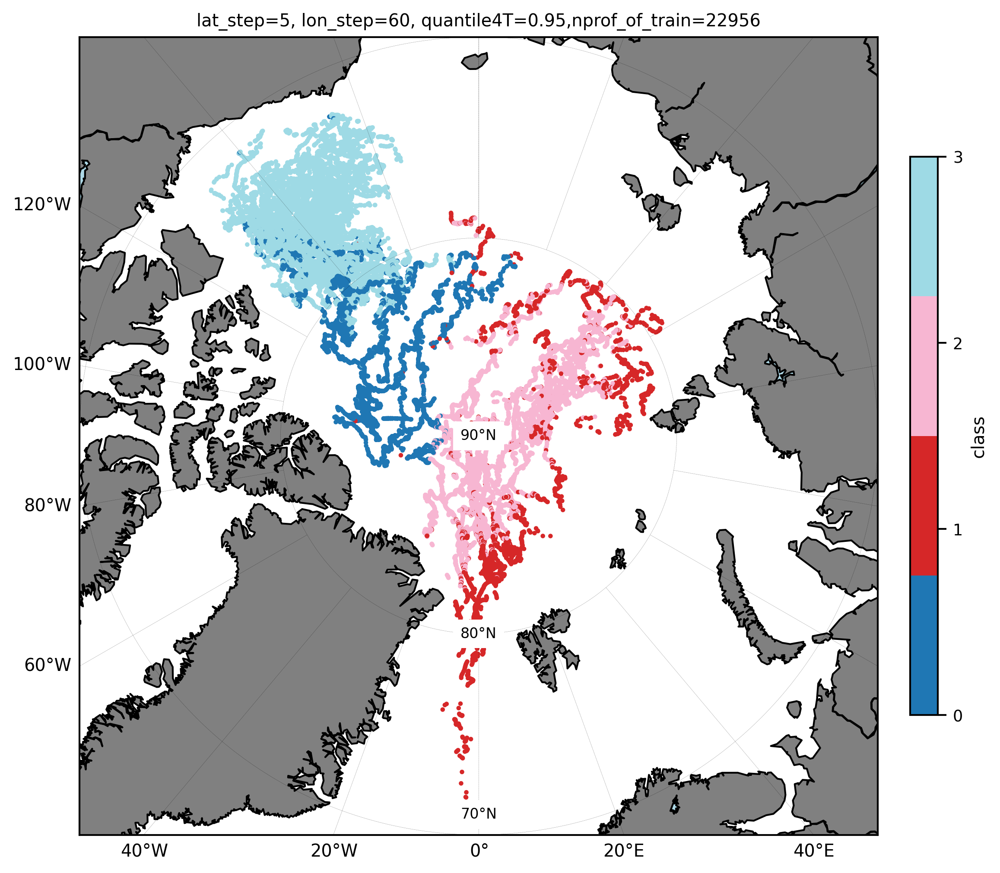

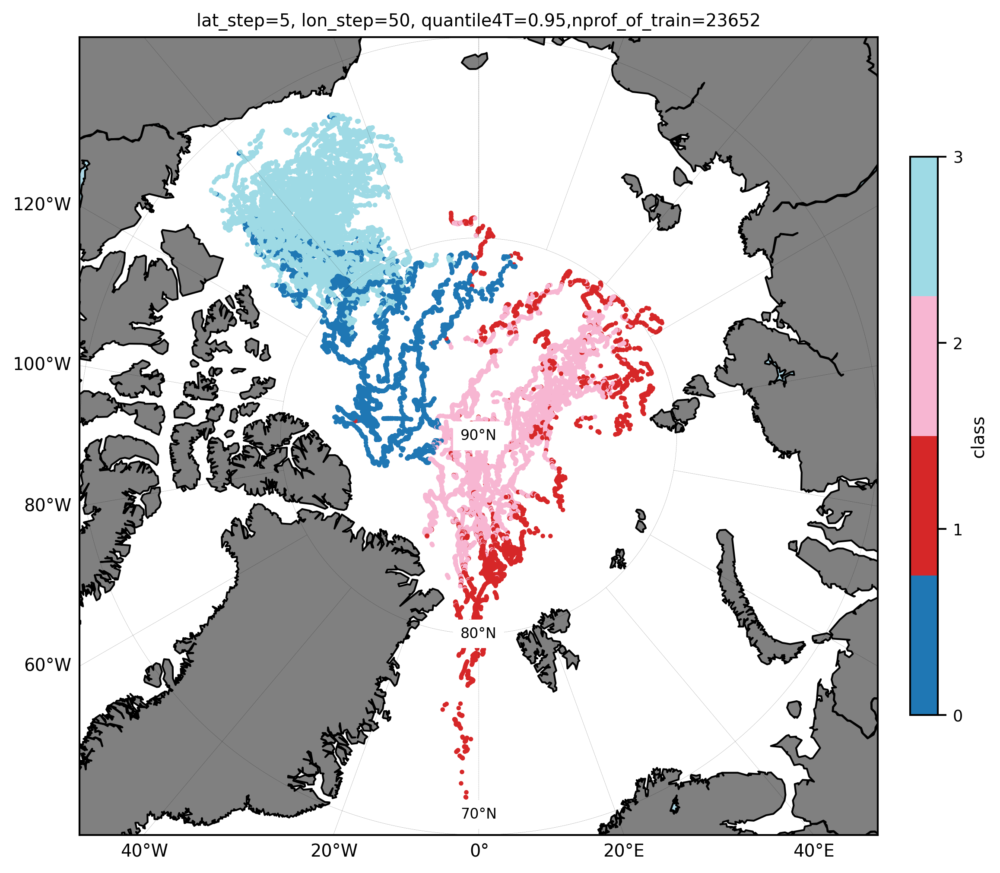

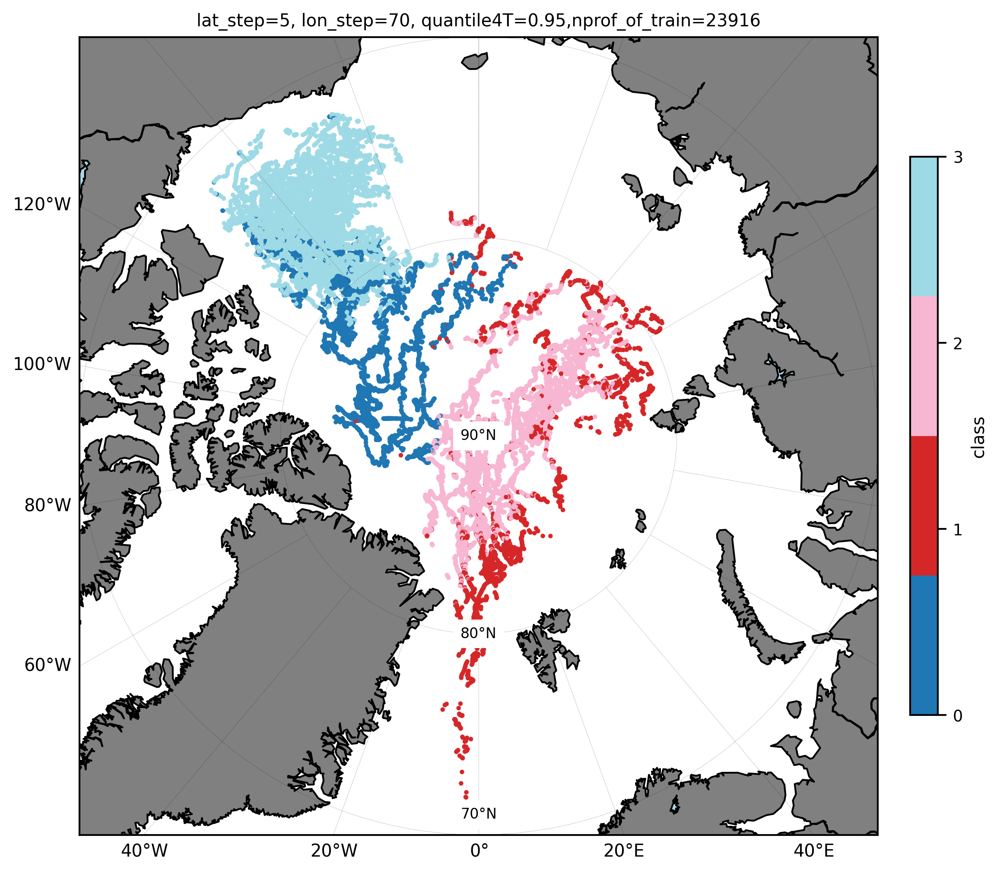

In [32]:
import GMM_functions as gf

gf.plot_labels(ds_fit_750_latlonT_5_60_95_k4,show_title=True)
gf.plot_labels(ds_fit_750_latlonT_5_50_95_k4,show_title=True)
gf.plot_labels(ds_fit_750_latlonT_5_70_95_k4,show_title=True)

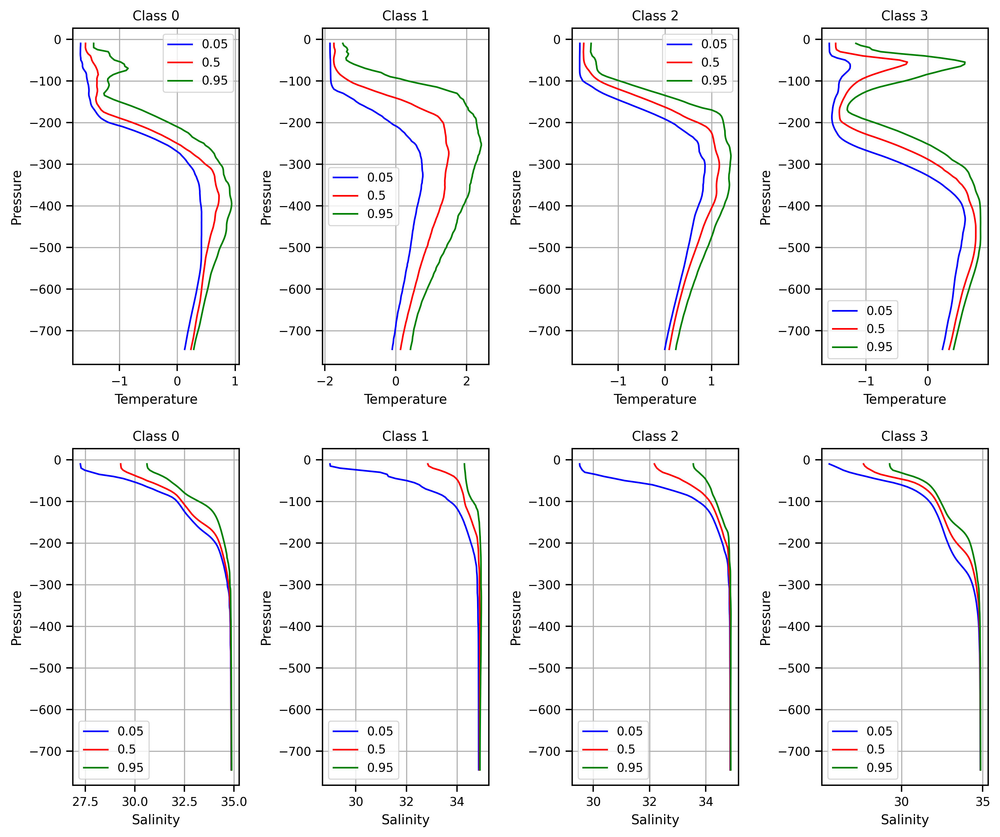

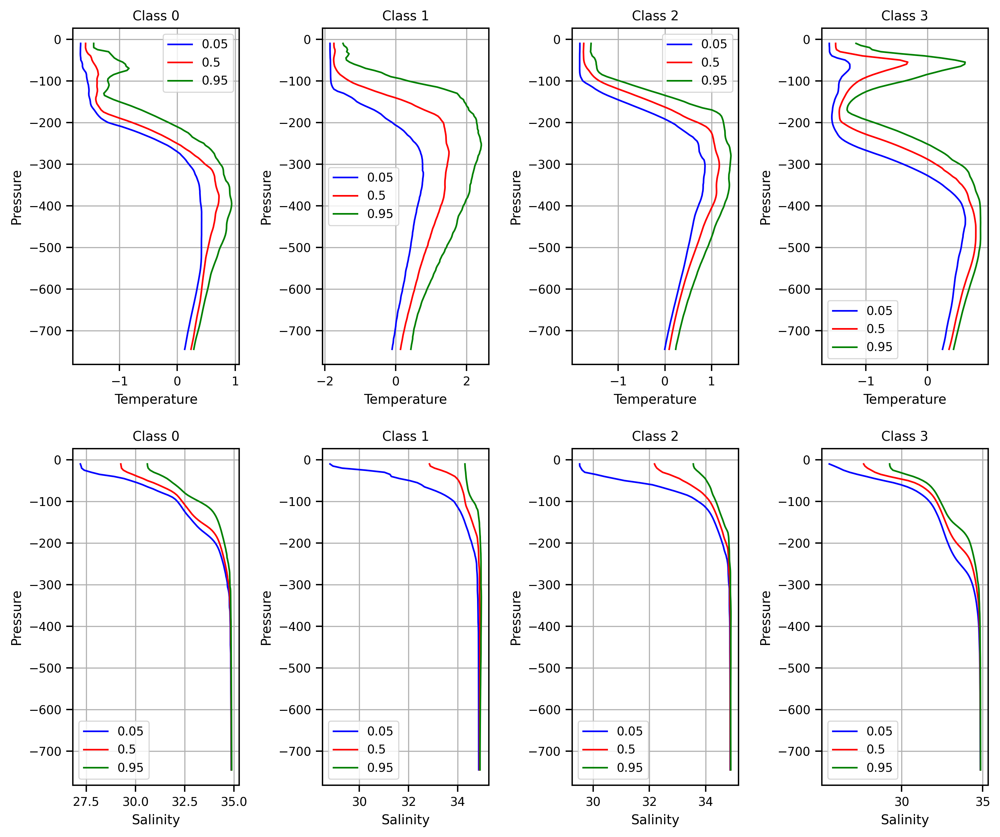

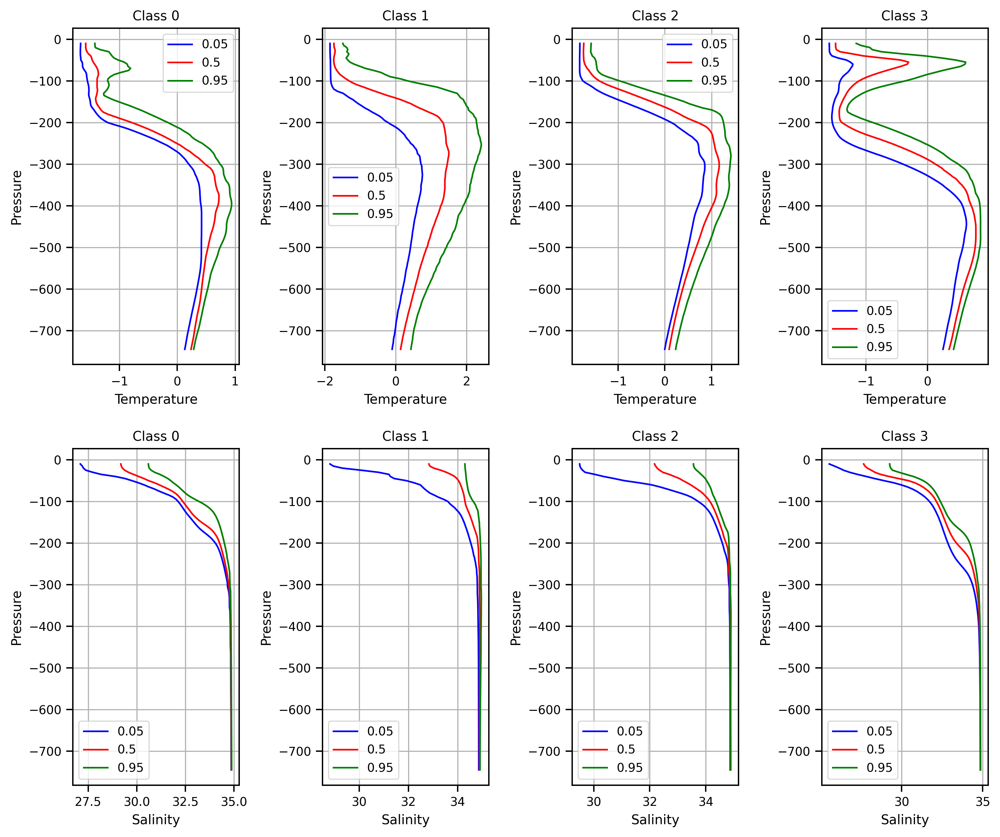

In [33]:
import GMM_functions as gf
gf.plot_mean_profile(ds_fit_750_latlonT_5_60_95_k4)
gf.plot_mean_profile(ds_fit_750_latlonT_5_50_95_k4)
gf.plot_mean_profile(ds_fit_750_latlonT_5_70_95_k4)

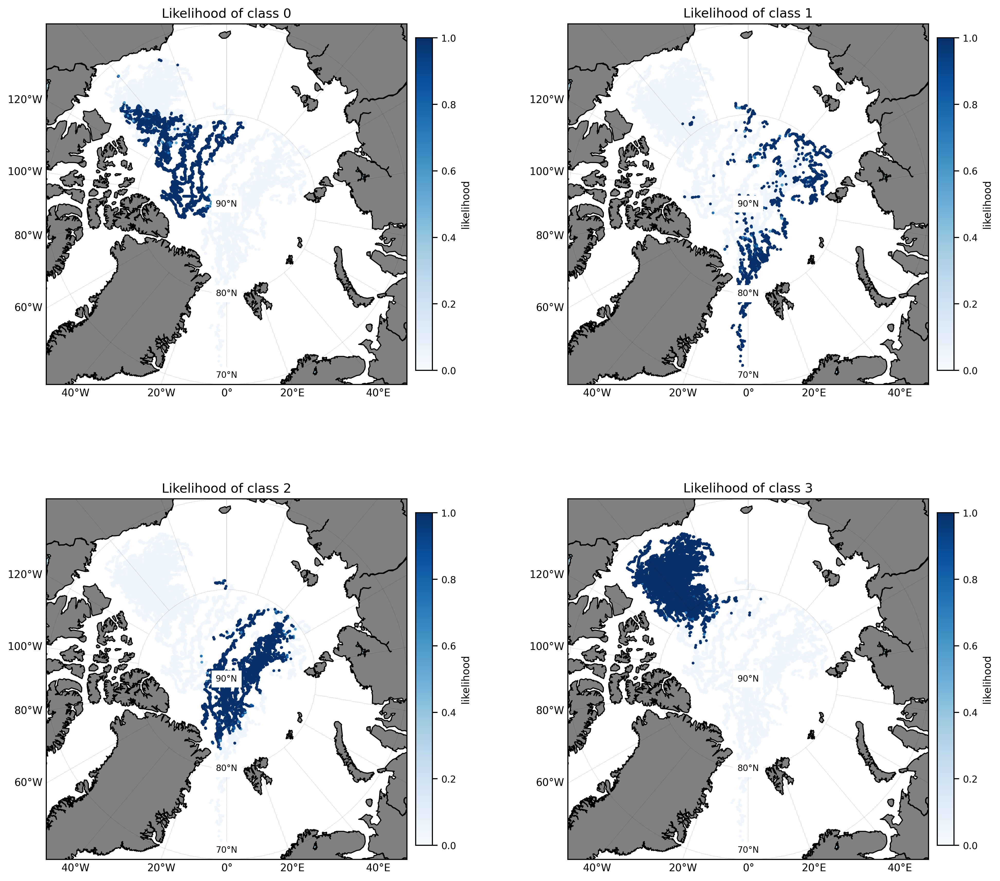

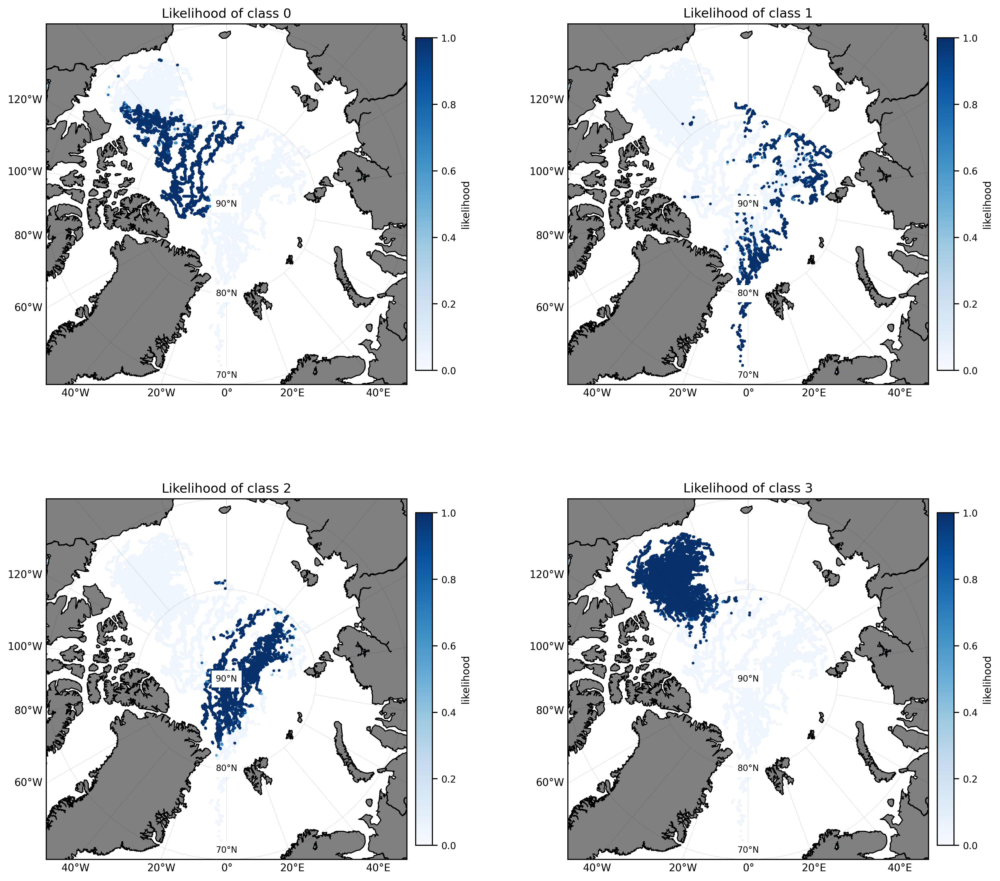

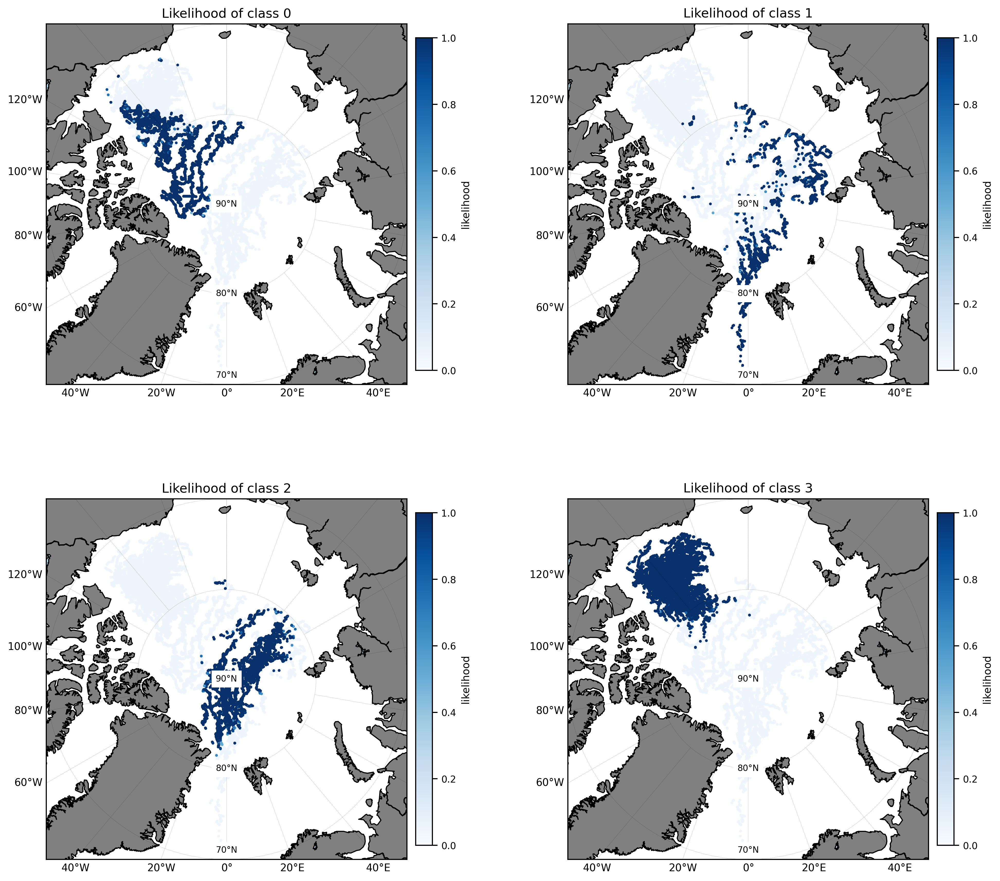

In [3]:
import GMM_functions as gf
gf.plot_single_class_likelihood(ds_fit_750_latlonT_5_60_95_k4)
gf.plot_single_class_likelihood(ds_fit_750_latlonT_5_50_95_k4)
gf.plot_single_class_likelihood(ds_fit_750_latlonT_5_70_95_k4)

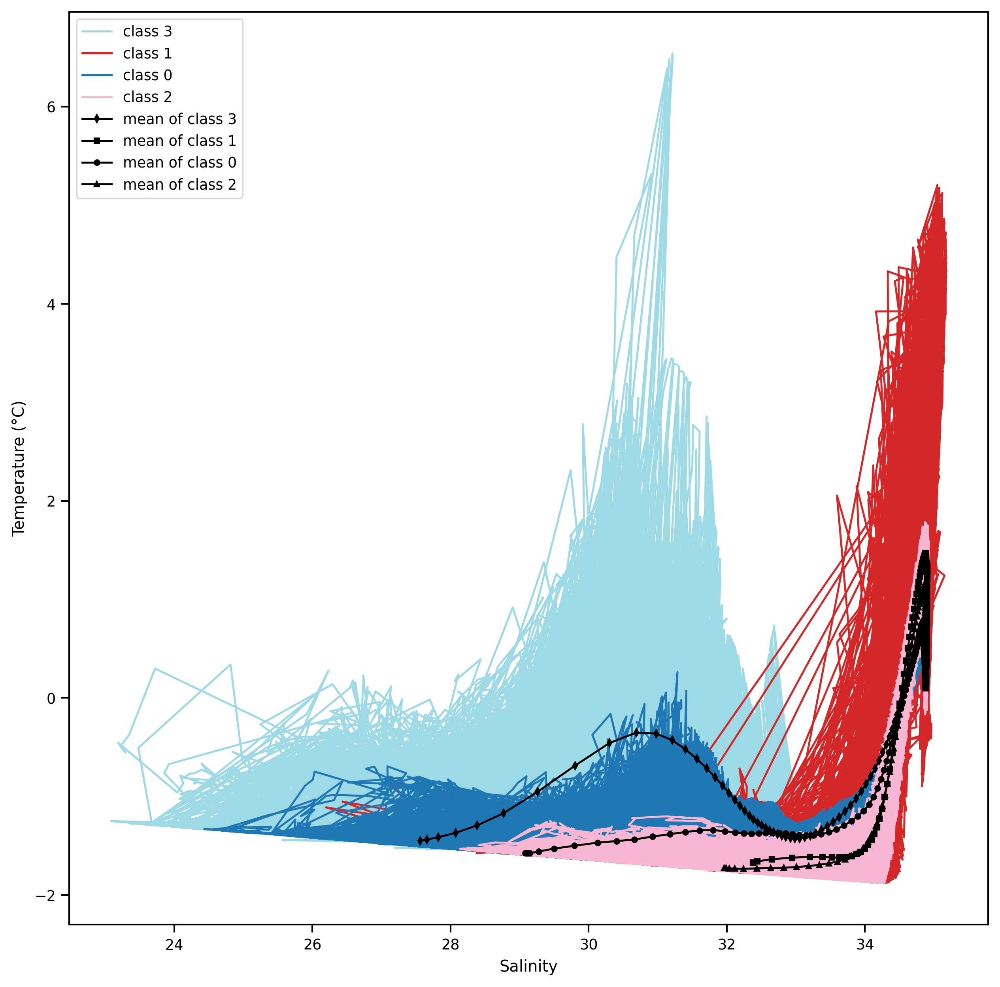

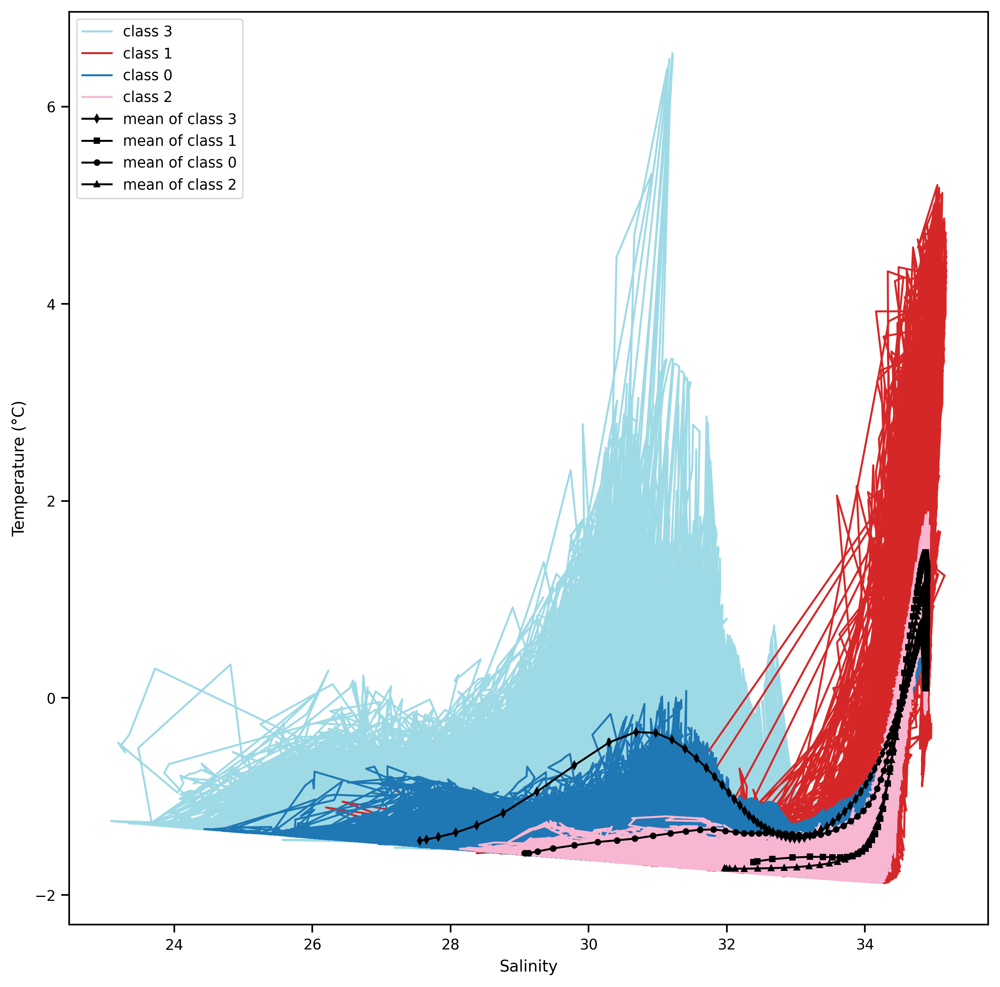

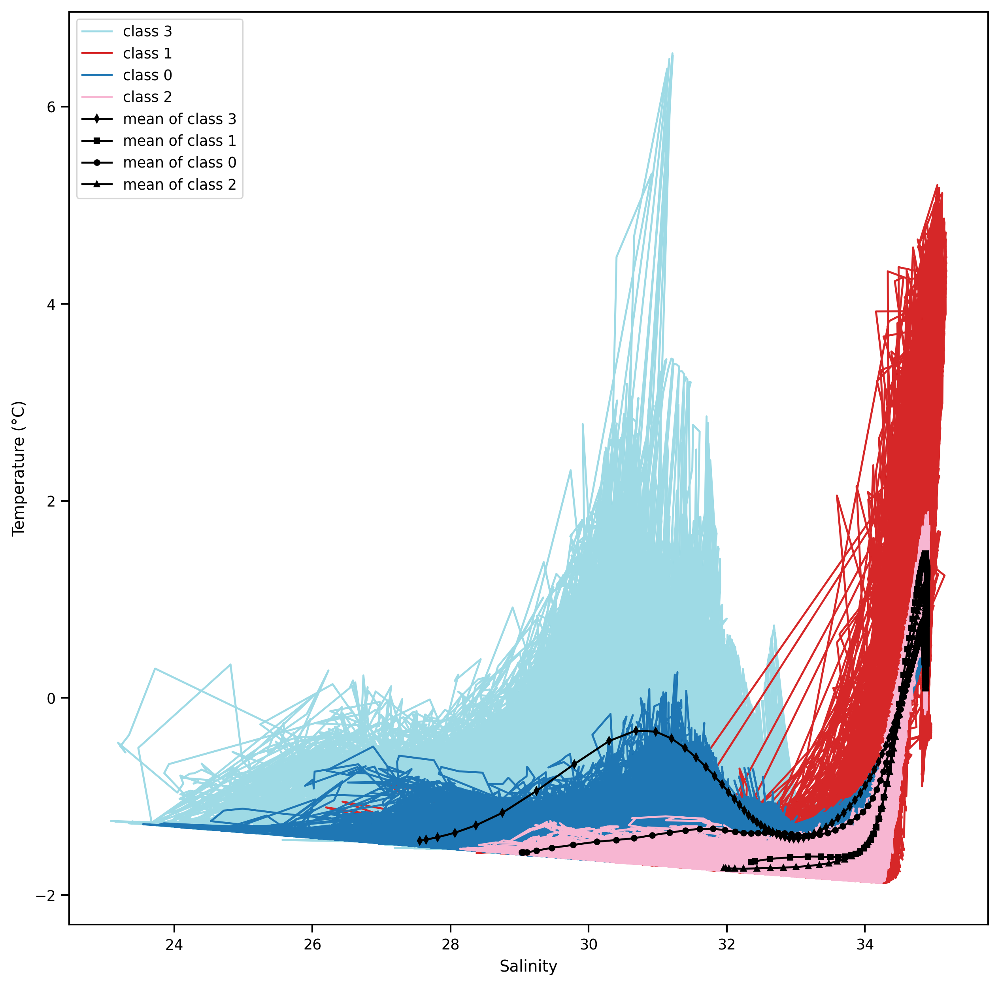

In [2]:
import GMM_functions as gf

gf.plot_san_temp_profiles(ds_fit_750_latlonT_5_60_95_k4)
gf.plot_san_temp_profiles(ds_fit_750_latlonT_5_50_95_k4)
gf.plot_san_temp_profiles(ds_fit_750_latlonT_5_70_95_k4)

In [2]:
# read the cleaned xarray from local file
import xarray as xr
data_path = 'D:/VScode/MRes/scienceweb.whoi.edu/itp/data/'
ds_cleaned_250=xr.open_dataset(f"{data_path}/ds_cleaned_250.nc")
# convert the profile data to string
ds_cleaned_250['profiler']=ds_cleaned_250['profiler'].astype(str)
# exclude the data with lat<60
ds_cleaned_250=ds_cleaned_250.where(ds_cleaned_250['lat']>60,drop=True)

In [3]:
import GMM_functions as gf

ds_fit_250_latlonT_10_20_95_k4 =gf.do_gmm(ds_cleaned_250,10,20,0.95,K=4)
ds_fit_250_latlonT_10_10_95_k4 =gf.do_gmm(ds_cleaned_250,10,10,0.95,K=4)
ds_fit_250_latlonT_10_30_95_k4 =gf.do_gmm(ds_cleaned_250,10,30,0.95,K=4)

Ratio is too large, selected_size_monthly is reset to the smallest_month_size: 2785
threshold=6904, training dataset size=33420
temperature has no _pyXpcm_cleanable attribute, skip it
salinity has no _pyXpcm_cleanable attribute, skip it
dissolved_oxygen has no _pyXpcm_cleanable attribute, skip it
lat_step has no _pyXpcm_cleanable attribute, skip it
lon_step has no _pyXpcm_cleanable attribute, skip it
quantile4T has no _pyXpcm_cleanable attribute, skip it
nprof_of_train has no _pyXpcm_cleanable attribute, skip it
Ratio is too large, selected_size_monthly is reset to the smallest_month_size: 2165
threshold=2065, training dataset size=25980
temperature has no _pyXpcm_cleanable attribute, skip it
salinity has no _pyXpcm_cleanable attribute, skip it
dissolved_oxygen has no _pyXpcm_cleanable attribute, skip it
lat_step has no _pyXpcm_cleanable attribute, skip it
lon_step has no _pyXpcm_cleanable attribute, skip it
quantile4T has no _pyXpcm_cleanable attribute, skip it
nprof_of_train has no _

In [5]:
# # save the fitted xarray to local file
# data_path = 'D:/VScode/MRes/scienceweb.whoi.edu/itp/data/'
# ds_fit_250_latlonT_10_20_95_k4.to_netcdf(f"{data_path}/ds_fit_250_latlonT_10_20_95_k4.nc")
# ds_fit_250_latlonT_10_10_95_k4.to_netcdf(f"{data_path}/ds_fit_250_latlonT_10_10_95_k4.nc")
# ds_fit_250_latlonT_10_30_95_k4.to_netcdf(f"{data_path}/ds_fit_250_latlonT_10_30_95_k4.nc")

In [23]:
# import the fitted xarray from local file
import xarray as xr
data_path = 'D:/VScode/MRes/scienceweb.whoi.edu/itp/data/'
ds_fit_250_latlonT_10_20_95_k4=xr.open_dataset(f"{data_path}/ds_fit_250_latlonT_10_20_95_k4.nc")
ds_fit_250_latlonT_10_10_95_k4=xr.open_dataset(f"{data_path}/ds_fit_250_latlonT_10_10_95_k4.nc")
ds_fit_250_latlonT_10_30_95_k4=xr.open_dataset(f"{data_path}/ds_fit_250_latlonT_10_30_95_k4.nc")

In [24]:
ds_fit_250_latlonT_10_20_95_k4=relabel_pcm_labels(ds_fit_250_latlonT_10_20_95_k4,label_mapping = {0: 0, 1: 2, 2: 1, 3: 3})

In [25]:
ds_fit_250_latlonT_10_10_95_k4=relabel_pcm_labels(ds_fit_250_latlonT_10_10_95_k4,label_mapping = {0: 2, 1: 3, 2: 1, 3: 0})

In [26]:
ds_fit_250_latlonT_10_30_95_k4=relabel_pcm_labels(ds_fit_250_latlonT_10_30_95_k4,label_mapping = {0: 3, 1: 2, 2: 0, 3: 1})

In [28]:
# # save the relabeled xarray to local file
# path_for_relabeled_data = 'D:/VScode/MRes/Clustering_under_the_ice/Relabeled_data'
# ds_fit_250_latlonT_10_20_95_k4.to_netcdf(f"{path_for_relabeled_data}/ds_fit_250_latlonT_10_20_95_k4.nc")
# ds_fit_250_latlonT_10_10_95_k4.to_netcdf(f"{path_for_relabeled_data}/ds_fit_250_latlonT_10_10_95_k4.nc")
# ds_fit_250_latlonT_10_30_95_k4.to_netcdf(f"{path_for_relabeled_data}/ds_fit_250_latlonT_10_30_95_k4.nc")

In [3]:
# read the relabeled xarray from local file
import xarray as xr
path_for_relabeled_data = 'D:/VScode/MRes/Clustering_under_the_ice/Relabeled_data'
ds_fit_250_latlonT_10_20_95_k4=xr.open_dataset(f"{path_for_relabeled_data}/ds_fit_250_latlonT_10_20_95_k4.nc")
ds_fit_250_latlonT_10_10_95_k4=xr.open_dataset(f"{path_for_relabeled_data}/ds_fit_250_latlonT_10_10_95_k4.nc")
ds_fit_250_latlonT_10_30_95_k4=xr.open_dataset(f"{path_for_relabeled_data}/ds_fit_250_latlonT_10_30_95_k4.nc")

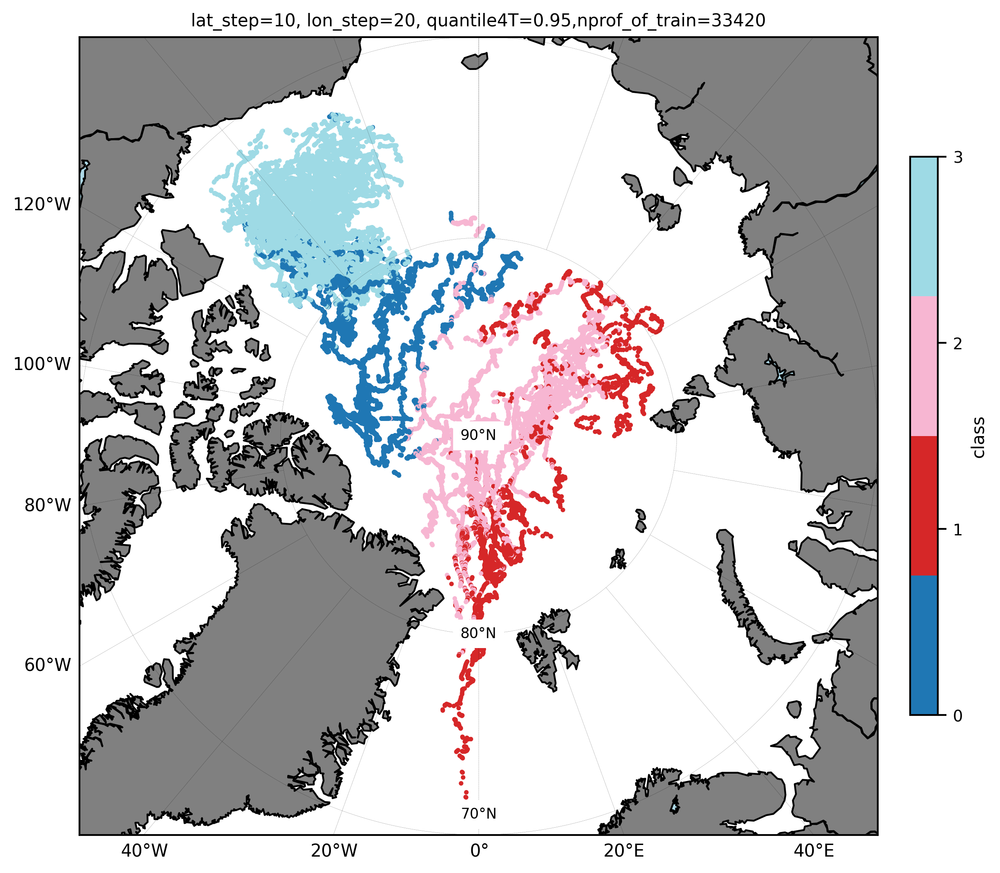

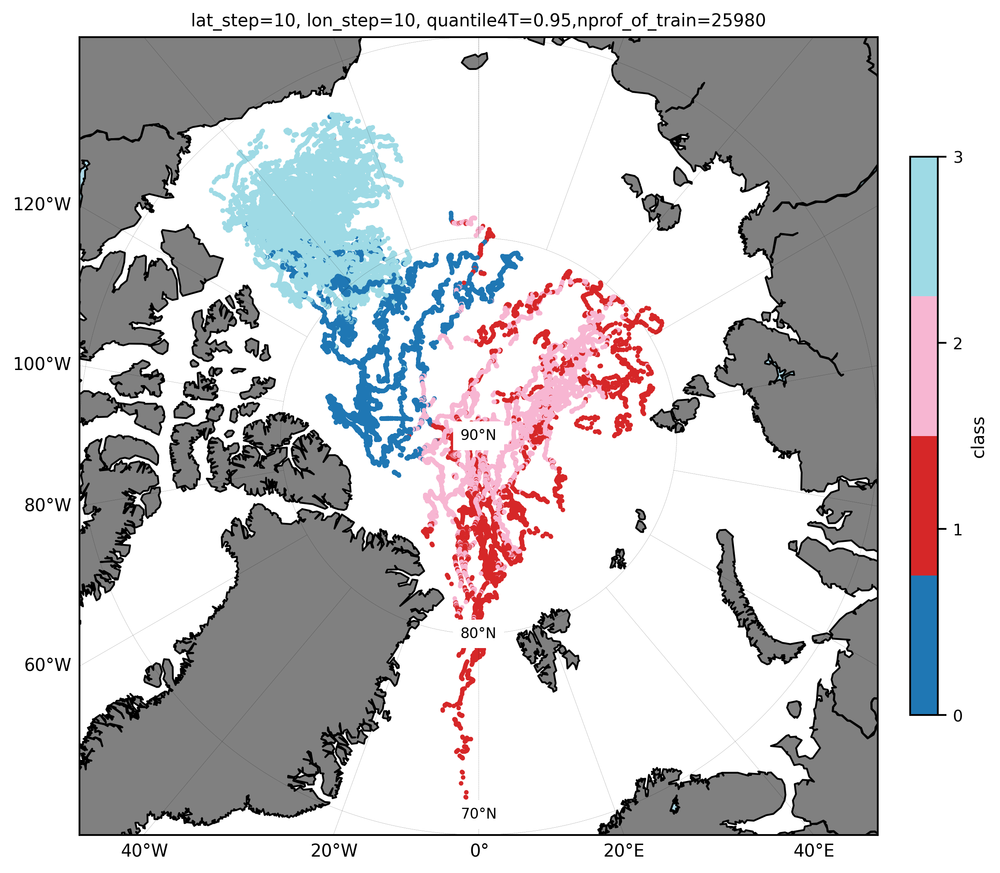

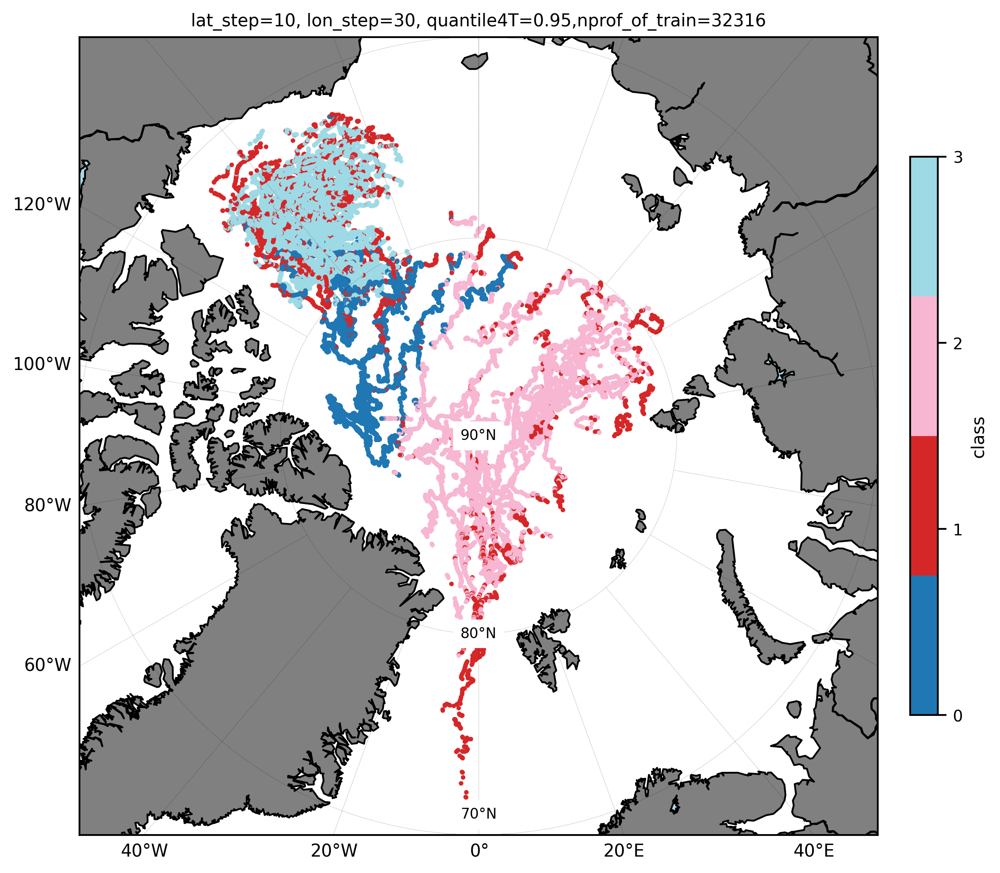

In [30]:
import GMM_functions as gf

gf.plot_labels(ds_fit_250_latlonT_10_20_95_k4,show_title=True)
gf.plot_labels(ds_fit_250_latlonT_10_10_95_k4,show_title=True)
gf.plot_labels(ds_fit_250_latlonT_10_30_95_k4,show_title=True)

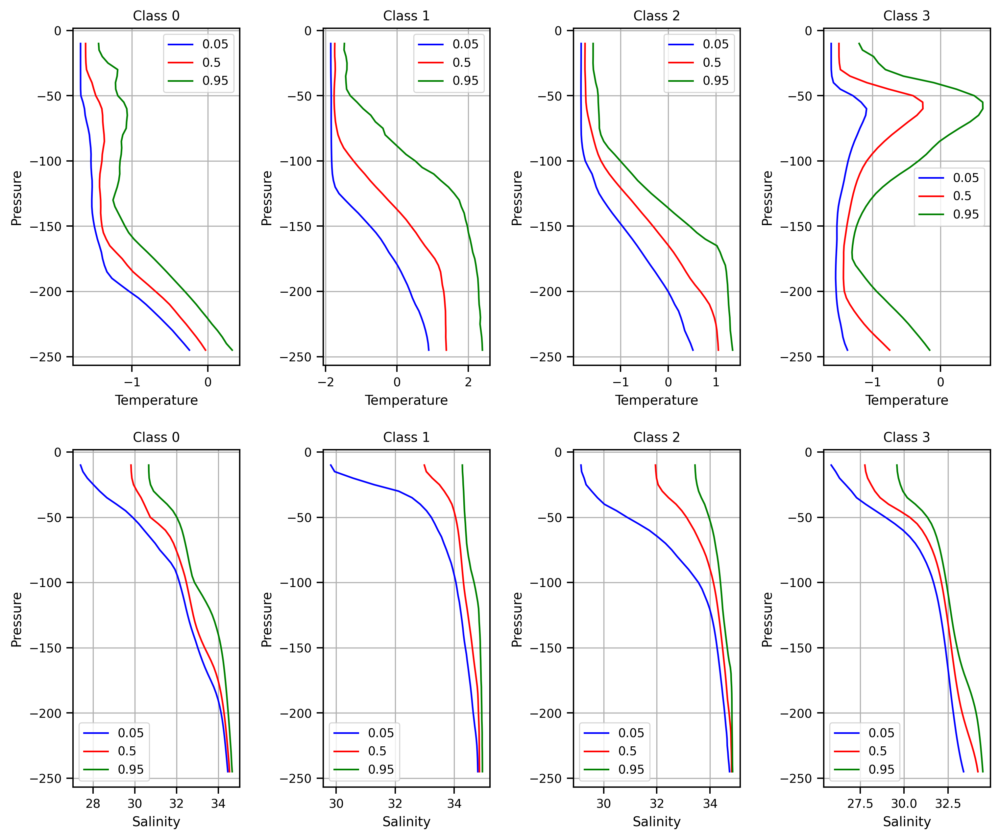

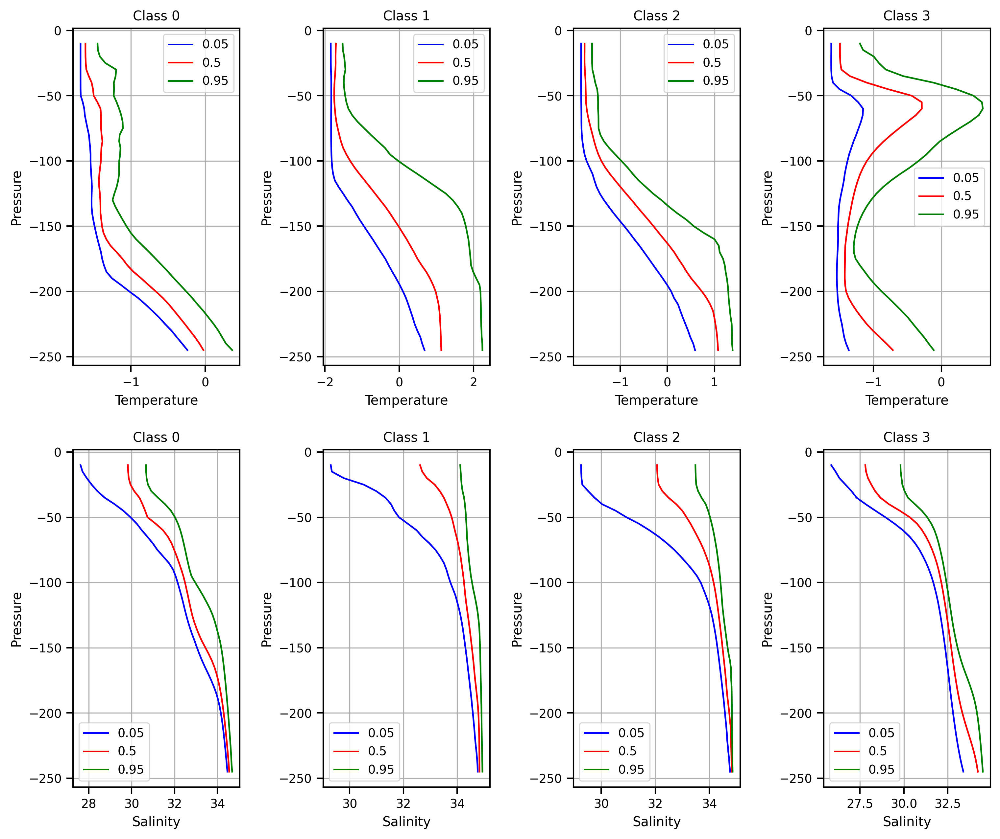

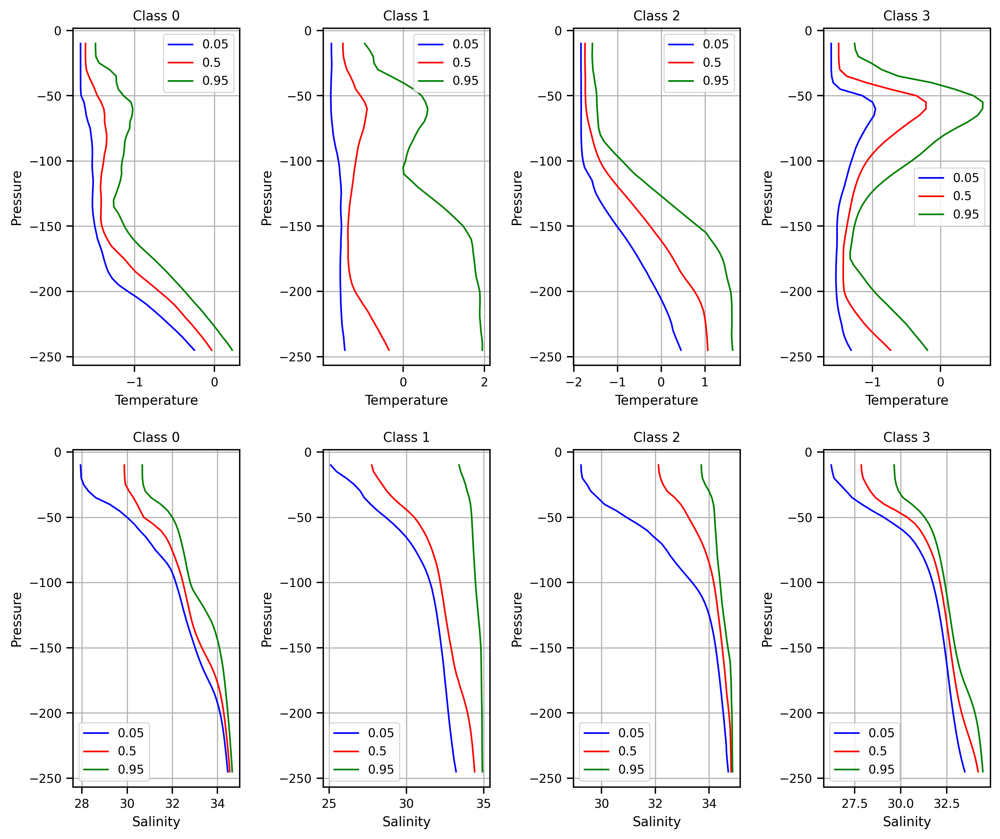

In [31]:
import GMM_functions as gf
gf.plot_mean_profile(ds_fit_250_latlonT_10_20_95_k4)
gf.plot_mean_profile(ds_fit_250_latlonT_10_10_95_k4)
gf.plot_mean_profile(ds_fit_250_latlonT_10_30_95_k4)

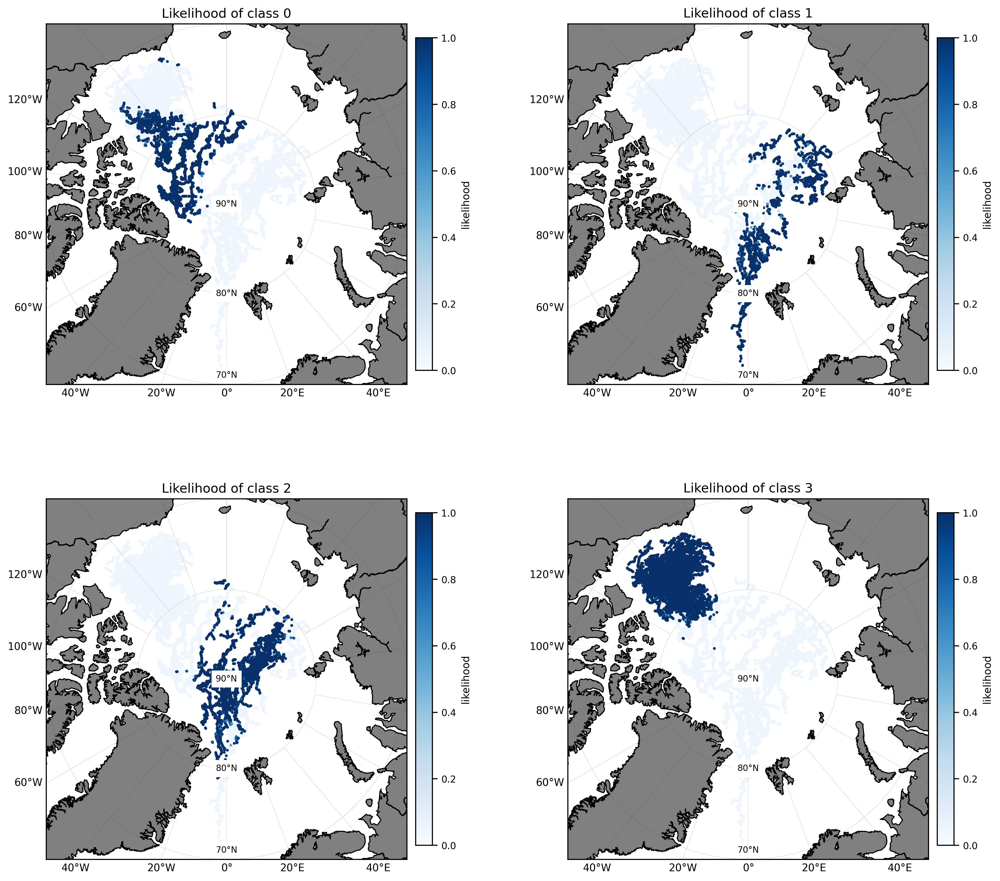

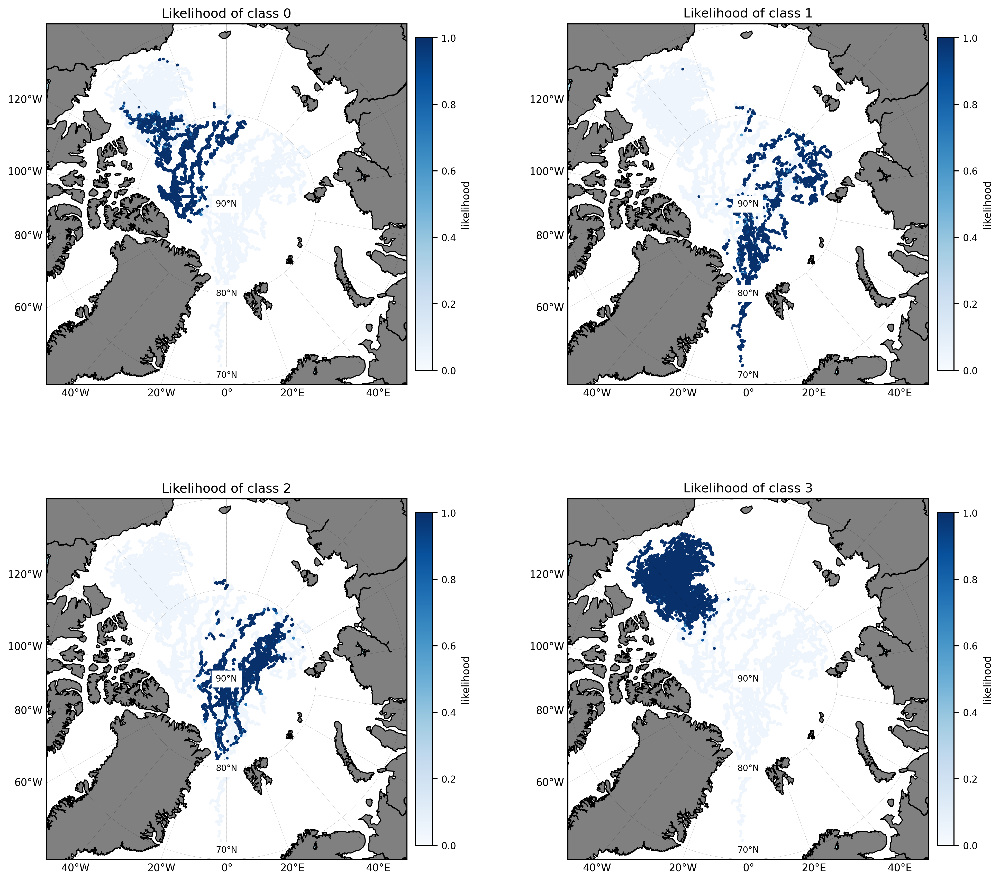

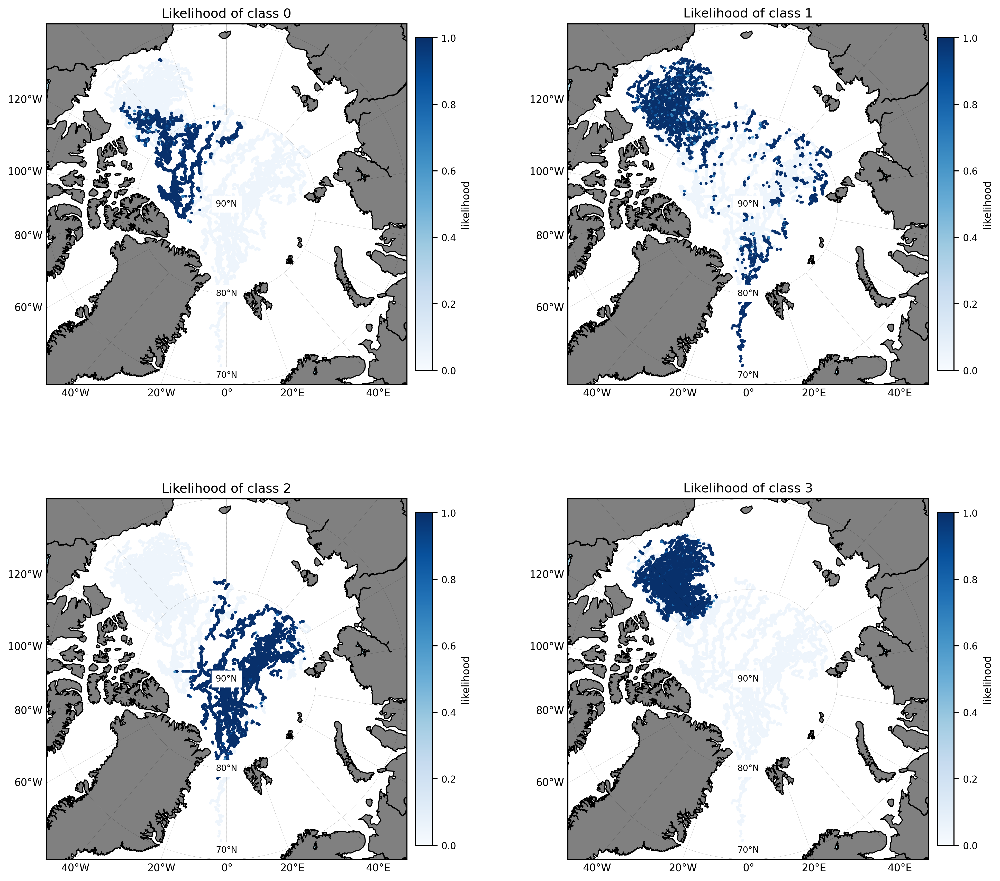

In [5]:
# plot the likelihood of each class
import GMM_functions as gf
gf.plot_single_class_likelihood(ds_fit_250_latlonT_10_20_95_k4)
gf.plot_single_class_likelihood(ds_fit_250_latlonT_10_10_95_k4)
gf.plot_single_class_likelihood(ds_fit_250_latlonT_10_30_95_k4)

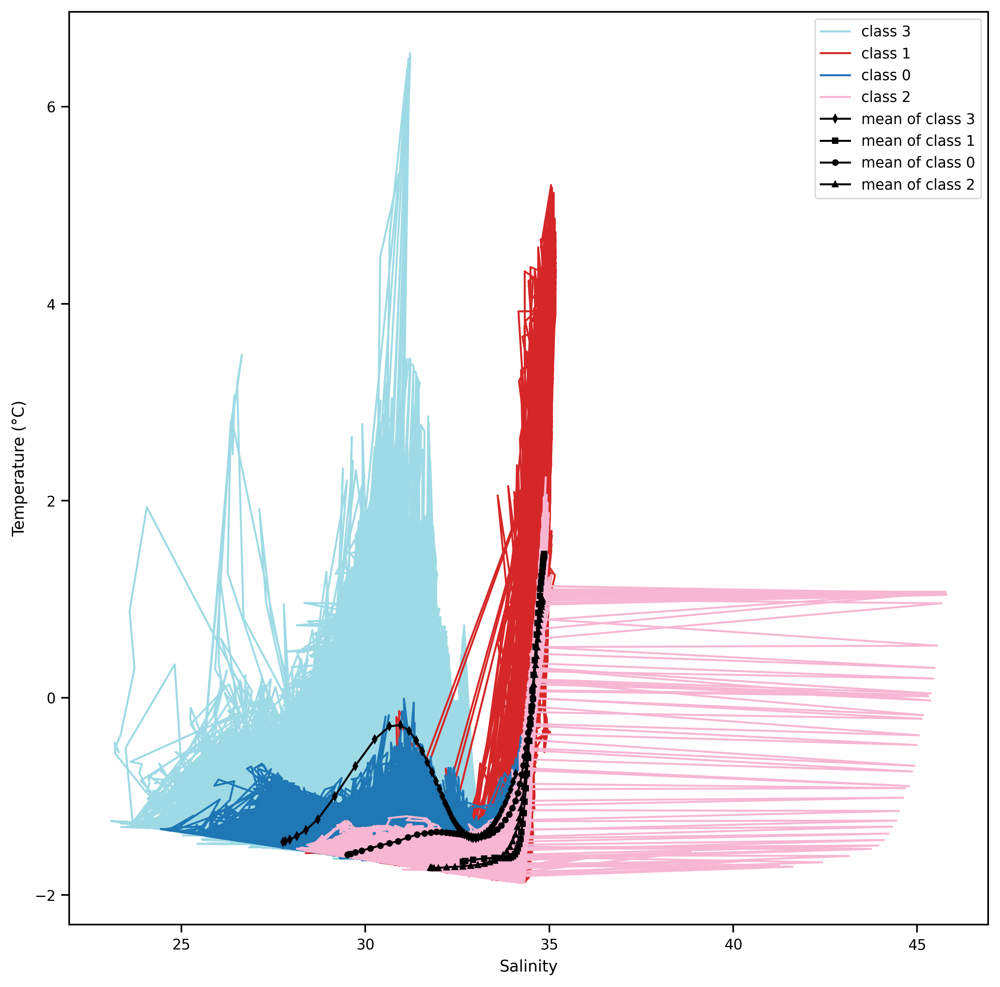

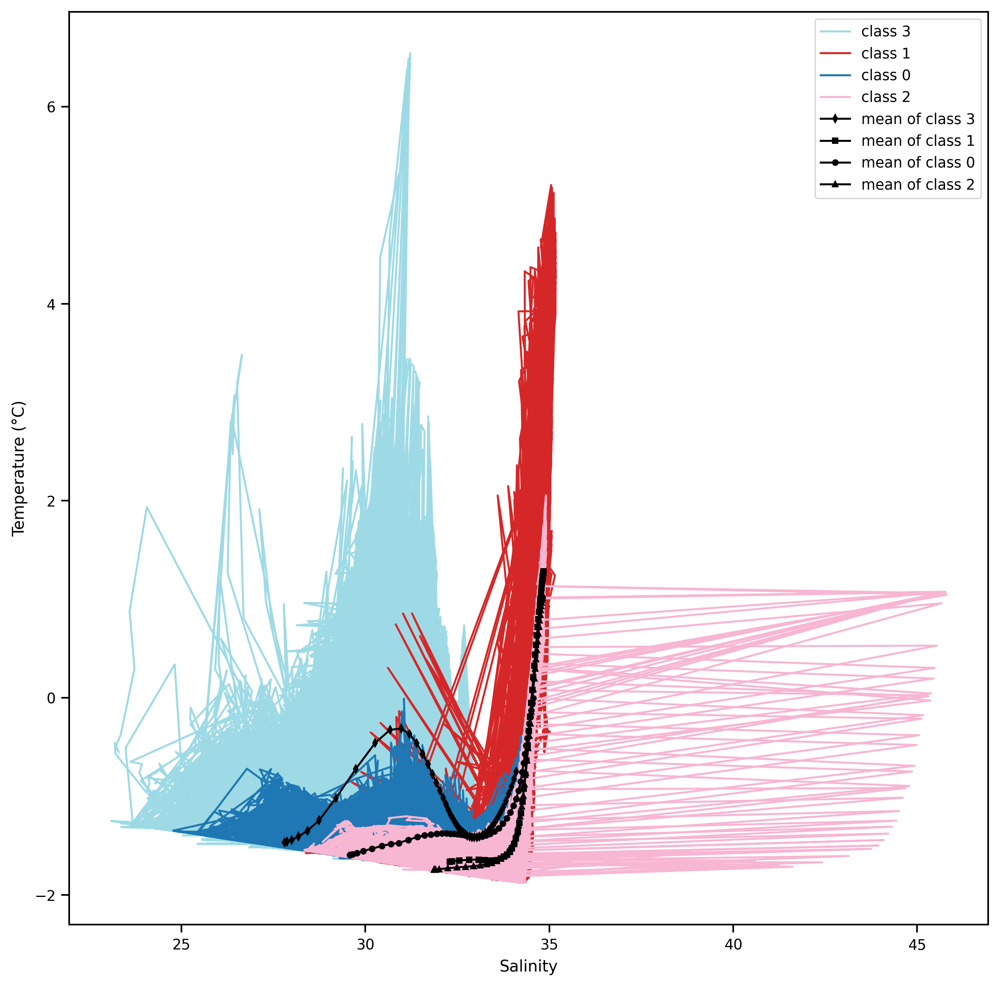

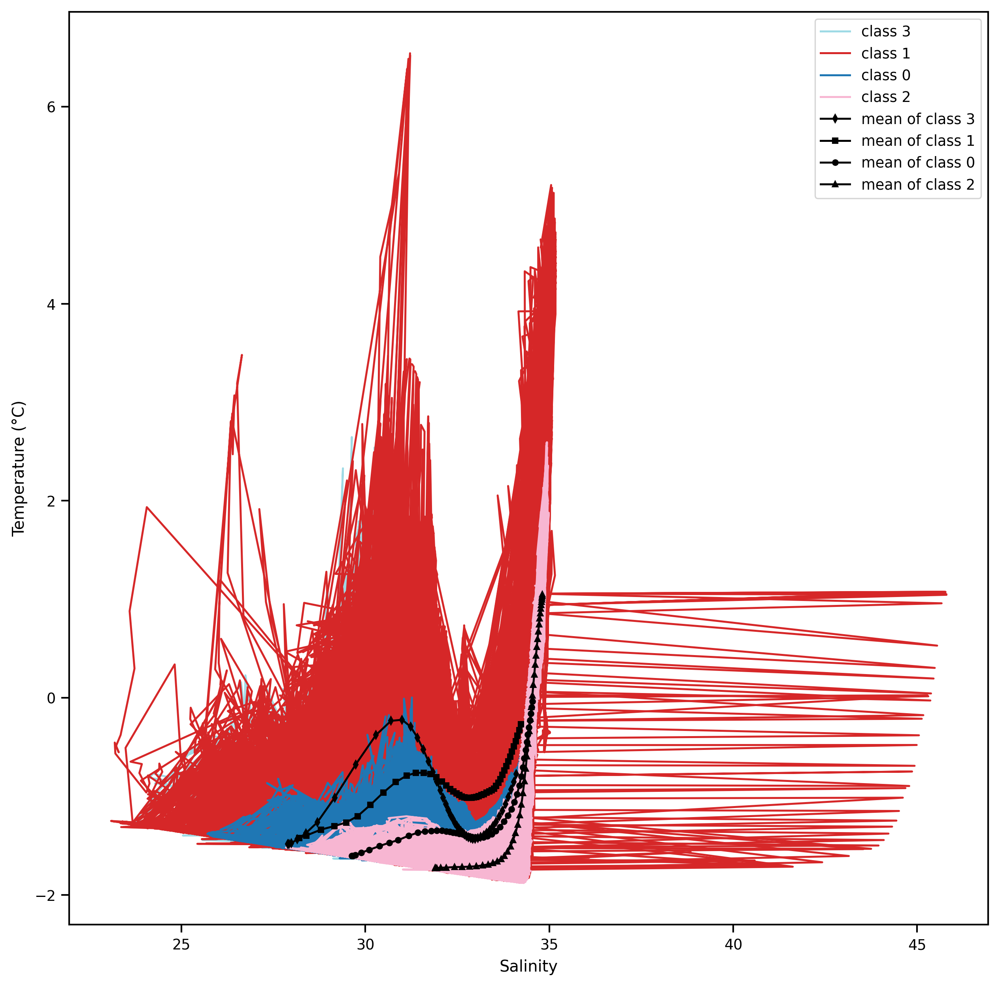

In [4]:
import GMM_functions as gf

gf.plot_san_temp_profiles(ds_fit_250_latlonT_10_20_95_k4)
gf.plot_san_temp_profiles(ds_fit_250_latlonT_10_10_95_k4)
gf.plot_san_temp_profiles(ds_fit_250_latlonT_10_30_95_k4)

In [ ]:
class_0_temperature_Q = ds_fit_750_latlonT_5_70_95_k4['temperature_Q'][0]
class_1_temperature_Q = ds_fit_750_latlonT_5_70_95_k4['temperature_Q'][1]
class_2_temperature_Q = ds_fit_750_latlonT_5_70_95_k4['temperature_Q'][2]
class_3_temperature_Q = ds_fit_750_latlonT_5_70_95_k4['temperature_Q'][3]

ds_fit_750_latlonT_5_70_95_k4['temperature_Q'][0]=class_0_temperature_Q
ds_fit_750_latlonT_5_70_95_k4['temperature_Q'][1]=class_3_temperature_Q
ds_fit_750_latlonT_5_70_95_k4['temperature_Q'][2]=class_1_temperature_Q
ds_fit_750_latlonT_5_70_95_k4['temperature_Q'][3]=class_2_temperature_Q


In [ ]:
# find the index for where the label is 0
import numpy as np
idx_0=np.where(ds_fit_750_latlonT_5_60_95_k4['PCM_LABELS']==0)
# idx_0
idx_1=np.where(ds_fit_750_latlonT_5_60_95_k4['PCM_LABELS']==1)
# idx_1
idx_2=np.where(ds_fit_750_latlonT_5_60_95_k4['PCM_LABELS']==2)
# idx_2
idx_3=np.where(ds_fit_750_latlonT_5_60_95_k4['PCM_LABELS']==3)

# set the values in idx_0 to 1
ds_fit_750_latlonT_5_60_95_k4['PCM_LABELS'][idx_0]=0
ds_fit_750_latlonT_5_60_95_k4['PCM_LABELS'][idx_1]=3
ds_fit_750_latlonT_5_60_95_k4['PCM_LABELS'][idx_2]=1
ds_fit_750_latlonT_5_60_95_k4['PCM_LABELS'][idx_3]=2

p0=ds_fit_750_latlonT_5_60_95_k4.PCM_POST.values[0].copy()
p1=ds_fit_750_latlonT_5_60_95_k4.PCM_POST.values[1].copy()
p2=ds_fit_750_latlonT_5_60_95_k4.PCM_POST.values[2].copy()
p3=ds_fit_750_latlonT_5_60_95_k4.PCM_POST.values[3].copy()

ds_fit_750_latlonT_5_60_95_k4.PCM_POST.values[0]=p0
ds_fit_750_latlonT_5_60_95_k4.PCM_POST.values[1]=p2
ds_fit_750_latlonT_5_60_95_k4.PCM_POST.values[2]=p3
ds_fit_750_latlonT_5_60_95_k4.PCM_POST.values[3]=p1

In [ ]:


# Define the mapping dictionary
label_mapping = {0: 0, 1: 3, 2: 1, 3: 2}

label_mapping[1]


3

In [69]:
ds_group = ds_fit_750_latlonT_5_50_95_k4.groupby('PCM_LABELS')

In [77]:
ds_group[3]['PCM_LABELS']

<xarray.DataArray 'PCM_LABELS' (nprof: 19990)>
array([3, 3, 3, ..., 3, 3, 3], dtype=int64)
Coordinates:
    profiler  (nprof) object ...
    date      (nprof) datetime64[ns] ...
    lon       (nprof) float64 -149.2 -148.8 -148.0 ... -133.2 -133.1 -133.1
    lat       (nprof) float64 80.04 80.1 80.18 80.28 ... 74.2 74.21 74.21 74.21
  * nprof     (nprof) int64 0 1 2 3 4 5 ... 43972 43973 43974 43975 43976 43977
Attributes:
    long_name:  PCM labels
    units:      
    valid_min:  0
    valid_max:  3
    llh:        15.321338512981912

In [80]:
ds_fit_750_latlonT_5_50_95_k4['PCM_LABELS']

<xarray.DataArray 'PCM_LABELS' (nprof: 44692)>
array([3, 3, 3, ..., 0, 0, 0], dtype=int64)
Coordinates:
    profiler  (nprof) object ...
    date      (nprof) datetime64[ns] ...
    lon       (nprof) float64 -149.2 -148.8 -148.0 ... -97.27 -97.41 -95.51
    lat       (nprof) float64 80.04 80.1 80.18 80.28 ... 82.73 82.69 82.65 82.75
  * nprof     (nprof) int64 0 1 2 3 4 5 ... 44686 44687 44688 44689 44690 44691
Attributes:
    long_name:  PCM labels
    units:      
    valid_min:  0
    valid_max:  3
    llh:        15.321338512981912

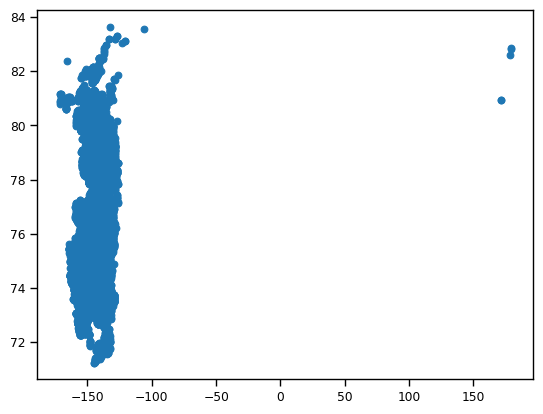

In [97]:
# plot the lon and lat distribution of PCM_LABELS=0
import matplotlib.pyplot as plt
plt.scatter(ds_fit_750_latlonT_5_50_95_k4['lon'][ds_fit_750_latlonT_5_50_95_k4['PCM_LABELS']==3],ds_fit_750_latlonT_5_50_95_k4['lat'][ds_fit_750_latlonT_5_50_95_k4['PCM_LABELS']==3])

# plot the lon and lat distribution of PCM_LABELS

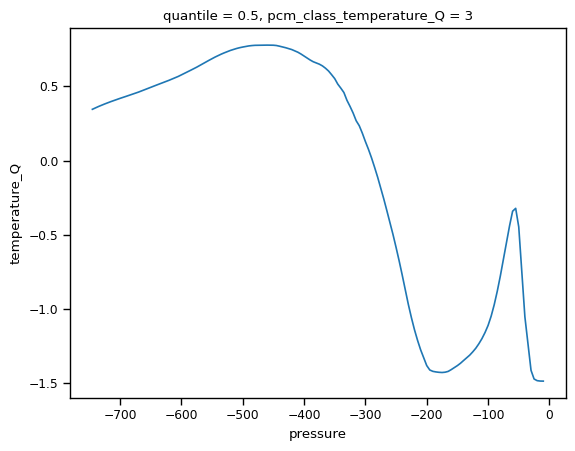

In [89]:
ds_fit_750_latlonT_5_50_95_k4['temperature_Q'][3][1].plot()

In [81]:
ds_fit_750_latlonT_5_70_95_k4['PCM_LABELS']

<xarray.DataArray 'PCM_LABELS' (nprof: 44692)>
array([3, 3, 3, ..., 0, 0, 0], dtype=int64)
Coordinates:
    profiler  (nprof) object ...
    date      (nprof) datetime64[ns] ...
    lon       (nprof) float64 -149.2 -148.8 -148.0 ... -97.27 -97.41 -95.51
    lat       (nprof) float64 80.04 80.1 80.18 80.28 ... 82.73 82.69 82.65 82.75
  * nprof     (nprof) int64 0 1 2 3 4 5 ... 44686 44687 44688 44689 44690 44691
Attributes:
    long_name:  PCM labels
    units:      
    valid_min:  0
    valid_max:  3
    llh:        15.589521502378057

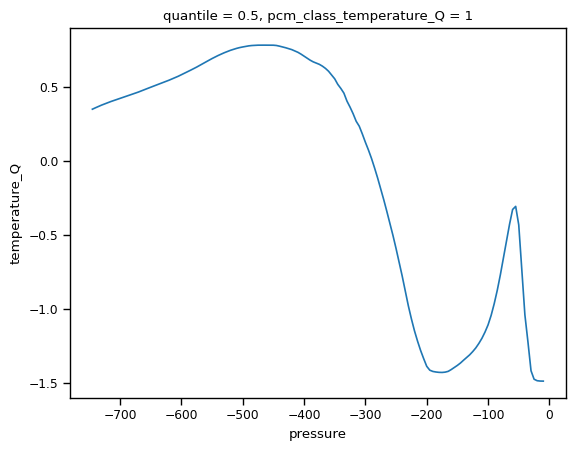

In [92]:
ds_fit_750_latlonT_5_70_95_k4['temperature_Q'][1][1].plot()

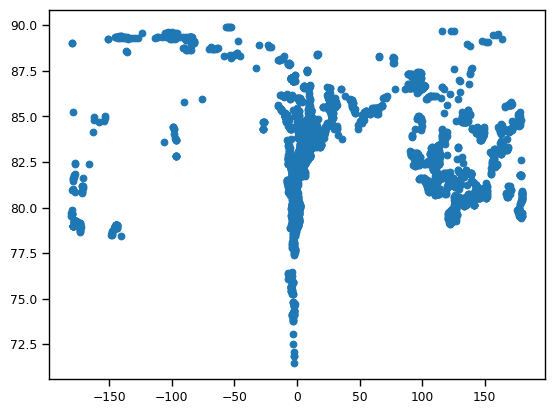

In [99]:
import matplotlib.pyplot as plt
plt.scatter(ds_fit_750_latlonT_5_70_95_k4['lon'][ds_fit_750_latlonT_5_70_95_k4['PCM_LABELS']==1],ds_fit_750_latlonT_5_70_95_k4['lat'][ds_fit_750_latlonT_5_70_95_k4['PCM_LABELS']==1])
